In [13]:
### --- importing the libraries 
import pandas as pd
import csv
import seaborn as sns
from datetime import datetime
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib import rc
import pandas as pd
import geopandas as gp
import plotly.graph_objects as go
import plotly.express as px
import plotly as py


In [14]:
### --- loading the data 
data = pd.read_csv("BasicCompanyDataAsOneFile-2021-12-01.csv")
postcodes = pd.read_csv('postcodes.csv')

/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3165: DtypeWarning:

Columns (41,42,43,44,45,46,47,48,49,50,51,52) have mixed types.Specify dtype option on import or set low_memory=False.

/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3165: DtypeWarning:

Columns (7,17,18,21,22,24,25,29,32,39,47) have mixed types.Specify dtype option on import or set low_memory=False.



## Cleaning 

In [15]:
data = data.drop(['RegAddress.CareOf', 'RegAddress.POBox', ' RegAddress.AddressLine2', 
       'DissolutionDate','Accounts.AccountRefDay','Accounts.AccountRefMonth',
       'Accounts.NextDueDate','Accounts.LastMadeUpDate','Accounts.AccountCategory','Returns.NextDueDate',
       'Returns.LastMadeUpDate',
       'URI', 'PreviousName_1.CONDATE',' PreviousName_1.CompanyName', 
       ' PreviousName_2.CONDATE',' PreviousName_2.CompanyName', 'PreviousName_3.CONDATE',
       ' PreviousName_3.CompanyName', 'PreviousName_4.CONDATE',' PreviousName_4.CompanyName', 
       'PreviousName_5.CONDATE',' PreviousName_5.CompanyName', 'PreviousName_6.CONDATE',
       ' PreviousName_6.CompanyName', 'PreviousName_7.CONDATE',' PreviousName_7.CompanyName', 
       'PreviousName_8.CONDATE',' PreviousName_8.CompanyName', 'PreviousName_9.CONDATE',
       ' PreviousName_9.CompanyName', 'PreviousName_10.CONDATE',' PreviousName_10.CompanyName', 
       'ConfStmtNextDueDate', ' ConfStmtLastMadeUpDate'], axis = 1)
data

,CompanyName,CompanyNumber,RegAddress.AddressLine1,RegAddress.PostTown,RegAddress.County,RegAddress.Country,RegAddress.PostCode,CompanyCategory,CompanyStatus,CountryOfOrigin,...,Mortgages.NumMortCharges,Mortgages.NumMortOutstanding,Mortgages.NumMortPartSatisfied,Mortgages.NumMortSatisfied,SICCode.SicText_1,SICCode.SicText_2,SICCode.SicText_3,SICCode.SicText_4,LimitedPartnerships.NumGenPartners,LimitedPartnerships.NumLimPartners
0,! LTD,08209948,METROHOUSE 57 PEPPER ROAD,LEEDS,YORKSHIRE,NaN,LS10 2RU,Private Limited Company,Active,United Kingdom,...,0,0,0,0,99999 - Dormant Company,NaN,NaN,NaN,0,0
1,!? LTD,11399177,THE STUDIO HATHERLOW HOUSE,ROMILEY,NaN,UNITED KINGDOM,SK6 3DY,Private Limited Company,Active,United Kingdom,...,0,0,0,0,47710 - Retail sale of clothing in specialised...,NaN,NaN,NaN,0,0
2,!BIG IMPACT GRAPHICS LIMITED,11743365,372 OLD STREET,LONDON,NaN,UNITED KINGDOM,EC1V 9LT,Private Limited Company,Active,United Kingdom,...,0,0,0,0,18129 - Printing n.e.c.,59112 - Video production activities,63120 - Web portals,74201 - Portrait photographic activities,0,0
3,!GOBERUB LTD,13404790,30 MAZE GREEN ROAD,BISHOP'S STORTFORD,NaN,ENGLAND,CM23 2PJ,Private Limited Company,Active,United Kingdom,...,0,0,0,0,62020 - Information technology consultancy act...,70229 - Management consultancy activities othe...,79110 - Travel agency activities,NaN,0,0
4,!NFOGENIE LTD,13522064,71-75 SHELTON STREET,LONDON,GREATER LONDON,UNITED KINGDOM,WC2H 9JQ,Private Limited Company,Active,United Kingdom,...,0,0,0,0,58290 - Other software publishing,NaN,NaN,NaN,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5016199,“THE GREENHOUSE” COMPANY LTD,11457383,IRONMASTER HOUSE,SHREWSBURY,SHROPSHIRE,ENGLAND,SY1 1XF,Private Limited Company,Active,United Kingdom,...,0,0,0,0,56101 - Licensed restaurants,NaN,NaN,NaN,0,0
5016200,“THE SKULL” SAUCE COMPANY LTD,SC660098,21/5 BURNBRAE PLACE,EDINBURGH,MIDLOTHIAN,NaN,EH12 8AR,Private Limited Company,Active,United Kingdom,...,0,0,0,0,10840 - Manufacture of condiments and seasonings,NaN,NaN,NaN,0,0
5016201,“UGUR-97” FIRMASI LTD,13707057,60 BROMPTON ROAD,LONDON,NaN,UNITED KINGDOM,SW3 1BW,Private Limited Company,Active,United Kingdom,...,0,0,0,0,68100 - Buying and selling of own real estate,NaN,NaN,NaN,0,0
5016202,“WORLD PLANET” HUMANITARIAN EXPEDITION GROUP LTD,12634115,OFFICE 4,KENSINGTON,LONDON,ENGLAND,W8 6BD,"PRI/LTD BY GUAR/NSC (Private, limited by guara...",Active,United Kingdom,...,0,0,0,0,94120 - Activities of professional membership ...,NaN,NaN,NaN,0,0


# SIC CODE Cleaning!

In [16]:
### --- Dropping NaN
data = data.dropna(subset=['SICCode.SicText_1'])

In [17]:
### --- removing dormant companies
data = data[data["SICCode.SicText_1"] != "99999 - Dormant Company"]

In [18]:
### --- removing none supplied option
data = data[data["SICCode.SicText_1"] != "None Supplied"]

In [19]:
### --- keeping only the first digits of the SIC code (2 digits)
data = data.loc[data["SICCode.SicText_1"].notnull()]

In [20]:
### --- creating a new column with the 2 digits of the SIC code 
data.loc[:, "SICCode_1_twod"] = data["SICCode.SicText_1"].str[0:2]


In [21]:
### --- changing the astype of our column
Sic1 = data['SICCode_1_twod'].to_numpy()
Sic1 = Sic1.astype(str).astype(int)
data['Sic1Names'] = Sic1

In [22]:
### --- creating a function for the SIC code names

def SICtoIndustry(SICCode):
    if SICCode in [i for i in range(1, 4)]:
        SICCode = "Agriculture, Forestry and Fishing"
    elif SICCode in [i for i in range(5, 10)]:
        SICCode = "Mining and Quarrying"
    elif SICCode in [i for i in range(10, 34)]:
        SICCode = "Manufacturing"
    elif SICCode == 35:
        SICCode = "Electricity, gas, steam and air conditioning supply"
    elif SICCode in [i for i in range(36, 40)]:
        SICCode = "Water supply, sewerage, waste management and remediation activities"
    elif SICCode in [i for i in range(41, 44)]:
        SICCode = "Construction"
    elif SICCode in [i for i in range(45, 48)]:
        SICCode = "Wholesale and retail trade; repair of motor vehicles and motorcycles"
    elif SICCode in [i for i in range(49, 54)]:
        SICCode = "Transportation and storage"
    elif SICCode in [i for i in range(55, 57)]:
        SICCode = "Accommodation and food service activities"
    elif SICCode in [i for i in range(58, 64)]:
        SICCode = "Information and communication"
    elif SICCode in [i for i in range(64, 67)]:
        SICCode = "Financial and insurance activities"
    elif SICCode == 68:
        SICCode = "Real estate activities"
    elif SICCode in [i for i in range(69, 76)]:
        SICCode = "Professional, scientific and technical activities"
    elif SICCode in [i for i in range(77, 83)]:
        SICCode = "Administrative and support service activities"
    elif SICCode == 84:
        SICCode = "Public administration and defence; compulsory social security"
    elif SICCode == 85:
        SICCode = "Education"
    elif SICCode in [i for i in range(86, 89)]:
        SICCode = "Human health and social work activities"
    elif SICCode in [i for i in range(90, 94)]:
        SICCode = "Arts, entertainment and recreation"
    elif SICCode in [i for i in range(94, 97)]:
        SICCode = "Other service activities"
    elif SICCode in [i for i in range(97, 99)]:
        SICCode = "Activities of households as employers; undifferentiated goods- and services-producing activities of households for own use"
    elif SICCode == 99:
        SICCode = "Activities of extraterritorial organisations and bodies"
    else:
        SICCode = np.NAN
    return SICCode

In [23]:
data["SIC_1_Industry"] = data["Sic1Names"].apply(SICtoIndustry)

# Incorporation Date cleaning

In [24]:
data['IncorporationDate'] = pd.to_datetime(data['IncorporationDate'], errors = 'coerce')

In [25]:
### --- adding new column
data["IncorporationMonth"] = data["IncorporationDate"].apply(lambda x: str(x.year))+"-" + data["IncorporationDate"].apply(lambda x: str(x.month))

# Region Cleaning

In [26]:
### --- UK dataset
uk = data[((data["RegAddress.Country"] == "UNITED KINGDOM") | (data["RegAddress.Country"] == "ENGLAND") | (data["RegAddress.Country"] == "SCOTLAND") |
                           (data["RegAddress.Country"] == "WALES") | (data["RegAddress.Country"] == "NORTHERN IRELAND"))]

In [27]:
### --- london dataset
london = uk[((uk["RegAddress.PostTown"] == "GREATER LONDON") | (uk["RegAddress.PostTown"] == "LONDON"))]

In [28]:
londonplot = london[["CompanyCategory", "SIC_1_Industry", "Mortgages.NumMortCharges", "Mortgages.NumMortSatisfied", "IncorporationMonth"]]

In [29]:
londonplot["IncorporationMonth"] = pd.to_datetime(londonplot["IncorporationMonth"], errors='coerce')


<ipython-input-29-495ea7d2f4bb>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [30]:
londonplot["IncorporationYear"] = londonplot["IncorporationMonth"].apply(lambda x: str(x.year))

<ipython-input-30-c8124af05ab7>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [31]:
londonplot = londonplot.sort_values(by=['IncorporationYear'])

In [32]:
bar =  londonplot.groupby('IncorporationYear')['Mortgages.NumMortSatisfied'].aggregate(np.sum)
bar = pd.DataFrame(bar)
bar["Year"] = ['1857', '1863', '1864', '1866', '1868', '1872', '1873', '1875',
       '1876', '1877', '1879', '1881', '1883', '1884', '1885', '1886',
       '1887', '1888', '1889', '1890', '1892', '1893', '1894', '1895',
       '1896', '1897', '1898', '1899', '1900', '1901', '1902', '1903',
       '1904', '1905', '1906', '1907', '1908', '1909', '1910', '1911',
       '1912', '1913', '1914', '1915', '1916', '1917', '1918', '1919',
       '1920', '1921', '1922', '1923', '1924', '1925', '1926', '1927',
       '1928', '1929', '1930', '1931', '1932', '1933', '1934', '1935',
       '1936', '1937', '1938', '1939', '1940', '1941', '1942', '1943',
       '1944', '1945', '1946', '1947', '1948', '1949', '1950', '1951',
       '1952', '1953', '1954', '1955', '1956', '1957', '1958', '1959',
       '1960', '1961', '1962', '1963', '1964', '1965', '1966', '1967',
       '1968', '1969', '1970', '1971', '1972', '1973', '1974', '1975',
       '1976', '1977', '1978', '1979', '1980', '1981', '1982', '1983',
       '1984', '1985', '1986', '1987', '1988', '1989', '1990', '1991',
       '1992', '1993', '1994', '1995', '1996', '1997', '1998', '1999',
       '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007',
       '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015',
       '2016', '2017', '2018', '2019', '2020', '2021']

In [33]:
bar["Year"] = pd.to_datetime(bar["Year"], errors='coerce')

In [34]:
bar = bar.sort_values(by=['Year'])

In [35]:
bar = bar[bar['Year'] >= "2000"]

In [36]:
bar["IncorporationYear"] = bar["Year"].apply(lambda x: str(x.year))

[Text(0.5, 0, 'Year'),
 Text(0, 0.5, 'Mortgages Satisfied'),
 Text(0.5, 1.0, 'Number of Mortgages Satisfied')]

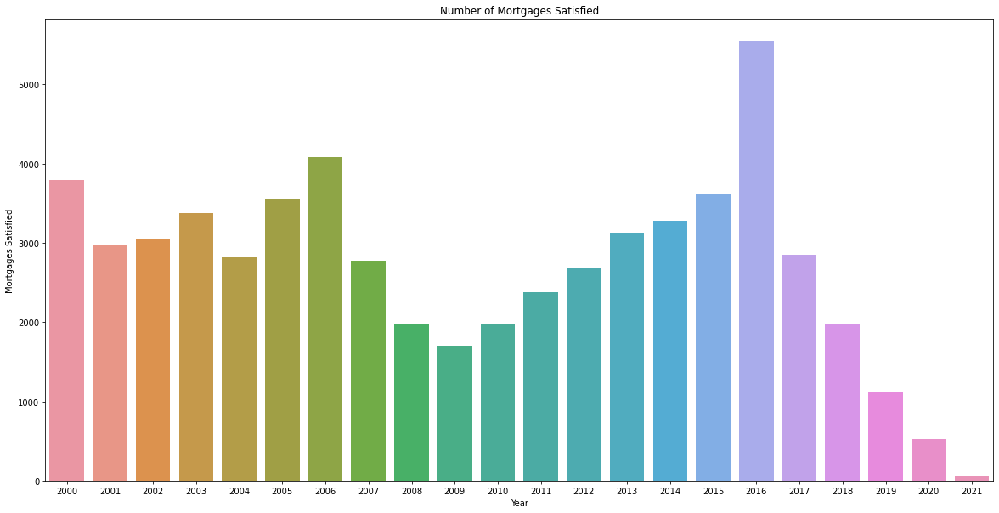

In [56]:
### --- plotting the data
plt.figure(figsize=(20,10))

fig = sns.barplot(data = bar, x="IncorporationYear" , y="Mortgages.NumMortSatisfied")

### --- setting the labels
fig.set(xlabel='Year', ylabel='Mortgages Satisfied', title='Number of Mortgages Satisfied')


In [38]:
pie = londonplot.groupby('SIC_1_Industry')['Mortgages.NumMortCharges'].aggregate(np.sum)
pie = pd.DataFrame(pie)
pie['SIC_1_Industry'] = ['Accommodation and food service activities', 'Activities of extraterritorial organisations and bodies', 'Activities of households as employers; undifferentiated goods- and services-producing activities of households for own use','Administrative and support service activities',
'Agriculture, Forestry and Fishing', 'Arts, entertainment and recreation', 'Construction', 'Education', 'Electricity, gas, steam and air conditioning supply', 'Financial and insurance activities',
'Human health and social work activities', 'Information and communication', 'Manufacturing', 'Mining and Quarrying', 'Other service activities', 'Professional, scientific and technical activities',
'Public administration and defence; compulsory social security', 'Real estate activities', 'Transportation and storage', 'Water supply, sewerage, waste management and remediation activities', 'Wholesale and retail trade; repair of motor vehicles and motorcycles']

In [55]:
### --- Number of Mortages charged in the covid area.

### --- plotting the pie
fig = plt.figure(figsize=(50,20))
fig = px.pie(pie, values='Mortgages.NumMortCharges', names='SIC_1_Industry', labels={'Mortgages.NumMortCharges':'NumberofMortages'})

fig.update_traces(textposition='inside', textinfo='percent+label')

### --- setting the labels
fig.update_layout(
    title_text="Number of Mortages Charged ")

fig.show()


<Figure size 3600x1440 with 0 Axes>

In [40]:
### --- UK in general data
rest_of_uk = uk[((uk["RegAddress.PostTown"] != "GREATER LONDON") & (uk["RegAddress.PostTown"] != "LONDON"))]

In [41]:
### --- preparing new dataset based on the postcodes.csv file 
x = data.copy()
y = postcodes[['Postcode', 'County', 'Country',
                'Latitude', 'Longitude', 'London zone']]

In [42]:
combined_df = pd.merge(x, y, how = 'left', left_on = 'RegAddress.PostCode', right_on = 'Postcode')

In [43]:
comdined_df = combined_df[~combined_df["Country"].isnull()]
combined_df = combined_df[(combined_df['Latitude'] != 0) & (combined_df['Longitude'] != 0)]
combined_df.drop(columns=["RegAddress.PostCode"], inplace=True)
combined_df.to_csv('cleaned_data.csv', index=False)

In [44]:
combined_df = combined_df.drop(['Sic1Names'], axis = 1)

In [45]:
### --- dataframe for the map
plot = combined_df[["SIC_1_Industry", "IncorporationMonth", "Latitude", "Longitude"]]

In [46]:
### --- taking only SIC code = 'Accomodation and food service activities'
plot = plot[plot.SIC_1_Industry == 'Accommodation and food service activities']

In [47]:
plot["IncorporationMonth"] = pd.to_datetime(plot["IncorporationMonth"], errors='coerce')

In [48]:
plot["IncorporationYear"] = plot["IncorporationMonth"].apply(lambda x: str(x.year))

In [49]:
### --- taking data after 2017.
plot = plot[plot['IncorporationYear'] >= "2017"]

In [50]:
plot = plot.sort_values(by = "IncorporationYear")

In [51]:
### --- map of the Uk with the accomondation and food activities after 2017
fig = px.scatter_mapbox(plot, lat="Latitude", lon="Longitude", hover_name="SIC_1_Industry", hover_data=["IncorporationYear"],
    color = 'IncorporationYear', zoom=4, width = 800 , height=800)

fig.update_layout(mapbox_style="open-street-map")
    
fig.show()
    